In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import cv2
import math

In [2]:
df = pd.read_csv('data/metadata.csv')
df

,patient_id,lesion_id,smoke,drink,background_father,background_mother,age,pesticide,gender,skin_cancer_history,...,diameter_2,diagnostic,itch,grew,hurt,changed,bleed,elevation,img_id,biopsed
0,PAT_1516,1765,NaN,NaN,NaN,NaN,8,NaN,NaN,NaN,...,NaN,NEV,False,False,False,False,False,False,PAT_1516_1765_530.png,False
1,PAT_46,881,False,False,POMERANIA,POMERANIA,55,False,FEMALE,True,...,5.0,BCC,True,True,False,True,True,True,PAT_46_881_939.png,True
2,PAT_1545,1867,NaN,NaN,NaN,NaN,77,NaN,NaN,NaN,...,NaN,ACK,True,False,False,False,False,False,PAT_1545_1867_547.png,False
3,PAT_1989,4061,NaN,NaN,NaN,NaN,75,NaN,NaN,NaN,...,NaN,ACK,True,False,False,False,False,False,PAT_1989_4061_934.png,False
4,PAT_684,1302,False,True,POMERANIA,POMERANIA,79,False,MALE,True,...,5.0,BCC,True,True,False,False,True,True,PAT_684_1302_588.png,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2293,PAT_1708,3156,NaN,NaN,NaN,NaN,73,NaN,NaN,NaN,...,NaN,ACK,True,False,False,False,False,False,PAT_1708_3156_175.png,False
2294,PAT_46,880,False,False,POMERANIA,POMERANIA,55,False,FEMALE,True,...,12.0,BCC,True,True,False,True,False,False,PAT_46_880_140.png,True
2295,PAT_1343,1217,NaN,NaN,NaN,NaN,74,NaN,NaN,NaN,...,NaN,SEK,False,False,False,False,False,False,PAT_1343_1217_404.png,False
2296,PAT_326,690,False,False,POMERANIA,POMERANIA,58,True,FEMALE,True,...,4.0,BCC,True,False,False,False,False,True,PAT_326_690_823.png,True


In [3]:
df_melanoma = df[df["diagnostic"] == "MEL"]
df_melanoma

,patient_id,lesion_id,smoke,drink,background_father,background_mother,age,pesticide,gender,skin_cancer_history,...,diameter_2,diagnostic,itch,grew,hurt,changed,bleed,elevation,img_id,biopsed
53,PAT_680,1289,True,False,PORTUGAL,ITALY,78,False,MALE,True,...,10.0,MEL,False,True,False,True,False,True,PAT_680_1289_182.png,True
86,PAT_995,1867,False,False,UNK,UNK,49,False,FEMALE,False,...,20.0,MEL,False,True,False,True,False,True,PAT_995_1867_5.png,True
112,PAT_966,1825,False,False,POMERANIA,POMERANIA,46,False,FEMALE,False,...,5.0,MEL,True,True,False,True,False,False,PAT_966_1825_584.png,True
164,PAT_966,1825,False,False,POMERANIA,POMERANIA,46,False,FEMALE,False,...,5.0,MEL,True,True,False,True,False,False,PAT_966_1825_546.png,True
262,PAT_495,941,False,False,POMERANIA,POMERANIA,58,True,MALE,False,...,11.0,MEL,False,UNK,False,True,False,False,PAT_495_941_26.png,True
266,PAT_614,1166,False,False,UNK,UNK,56,False,FEMALE,False,...,6.0,MEL,False,True,False,True,False,False,PAT_614_1166_885.png,True
281,PAT_340,714,False,True,ITALY,ITALY,54,False,FEMALE,False,...,12.0,MEL,True,True,False,True,False,True,PAT_340_714_68.png,True
296,PAT_115,1138,False,False,POMERANIA,POMERANIA,70,False,MALE,False,...,8.0,MEL,False,True,False,True,False,True,PAT_115_1138_870.png,True
338,PAT_895,1699,False,False,GERMANY,PORTUGAL,65,False,FEMALE,False,...,10.0,MEL,False,UNK,False,UNK,False,False,PAT_895_1699_872.png,True
412,PAT_233,354,False,False,POMERANIA,POMERANIA,58,True,FEMALE,True,...,4.0,MEL,False,True,False,True,False,True,PAT_233_354_935.png,True


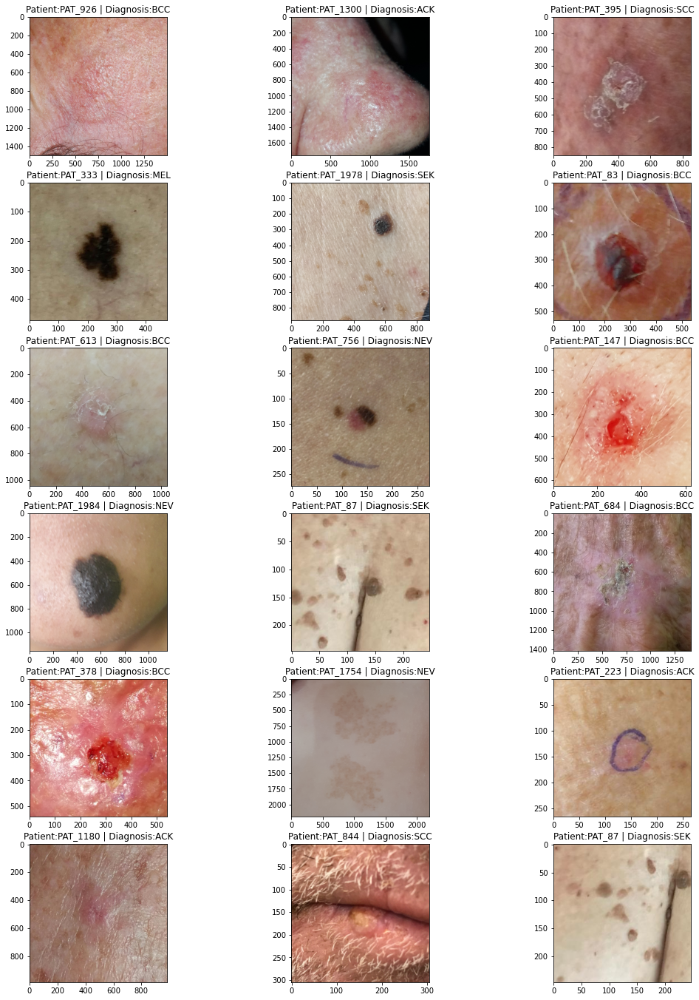

In [4]:
def show_sample_pictures(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,3*((n_samples+6)//3)))
    axList = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//3,3,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        axList[i].imshow(img)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))
    # fig.show()

diseases = df['diagnostic'].unique()

show_sample_pictures(df, 18)

In [5]:
diseases

array(['NEV', 'BCC', 'ACK', 'SEK', 'SCC', 'MEL'], dtype=object)

In [6]:
# Função para detectar contornos (Canny)

def auto_canny(image, sigma=0.33):
    v = np.median(image)
    lower = int(max(0, (1.0 - sigma) * v))
    upper = int(min(255, (1.0 + sigma) * v))
    edged = cv2.Canny(image, lower, upper)
    return edged

In [7]:
# Função para aplicar um equalizador de histograma adaptativo (CLAHE)
def adaptive_histeq(img_gray):
      clahe = cv2.createCLAHE(clipLimit = 2.0, tileGridSize=(8,8))
      final_img = clahe.apply(img_gray) 
      return final_img

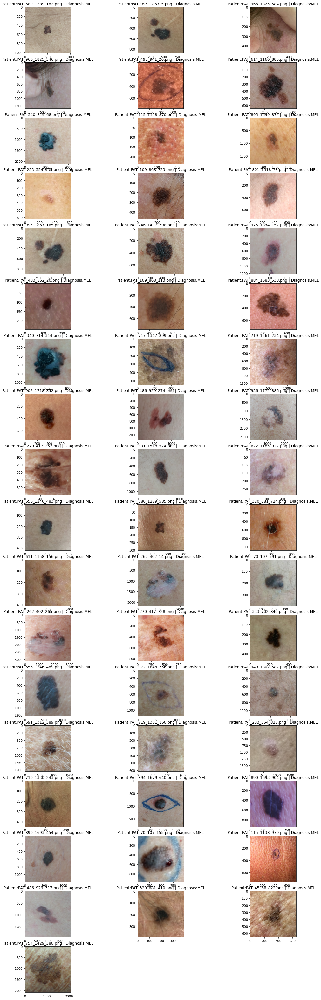

In [8]:
n_samples=52#df_melanoma.shape[0]
imgs = df_melanoma['img_id'].to_list()
diganosis = df_melanoma['diagnostic'].to_list()
patients = df_melanoma['patient_id'].to_list()
fig = plt.figure(figsize=(18,3*((n_samples+6)//3)))
axList = []
for i in range(n_samples):
    axList.append(fig.add_subplot((2+n_samples)//3,3,i+1))
    filename = 'data/images/'+imgs[i]
    img = cv2.imread(filename)[:,:,::-1]
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    
    kernel = cv2.getStructuringElement(1,(7,7))
    closing = cv2.morphologyEx(gray,cv2.MORPH_CLOSE,kernel, iterations = 2)

    imgeq = cv2.equalizeHist(gray)
    
    clahe=adaptive_histeq(gray)

    #axList[i].imshow(clahe, cmap='gray', vmin = 0, vmax = 255)
    axList[i].imshow(img)
    axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(imgs[i], diganosis[i]))



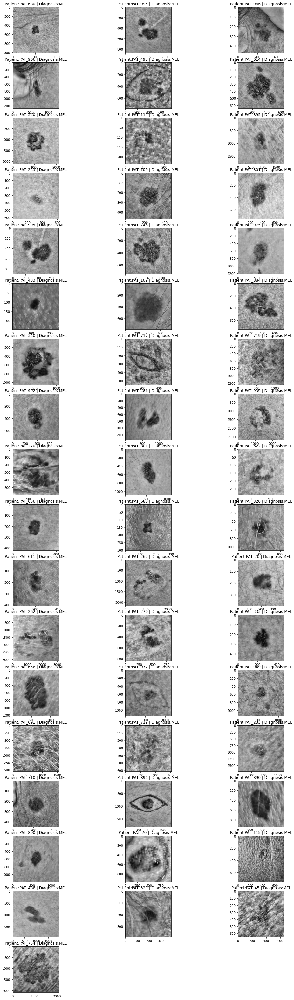

In [9]:
n_samples=52#df_melanoma.shape[0]
imgs = df_melanoma['img_id'].to_list()
diganosis = df_melanoma['diagnostic'].to_list()
patients = df_melanoma['patient_id'].to_list()
fig = plt.figure(figsize=(18,3*((n_samples+6)//3)))
axList = []
for i in range(n_samples):
    axList.append(fig.add_subplot((2+n_samples)//3,3,i+1))
    filename = 'data/images/'+imgs[i]
    img = cv2.imread(filename)[:,:,::-1]
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    
    kernel = cv2.getStructuringElement(1,(7,7))
    closing = cv2.morphologyEx(gray,cv2.MORPH_CLOSE,kernel, iterations = 2)

    imgeq = cv2.equalizeHist(gray)
    
    clahe=adaptive_histeq(gray)

    axList[i].imshow(clahe, cmap='gray', vmin = 0, vmax = 255)
    #axList[i].imshow(imgeq)
    axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))



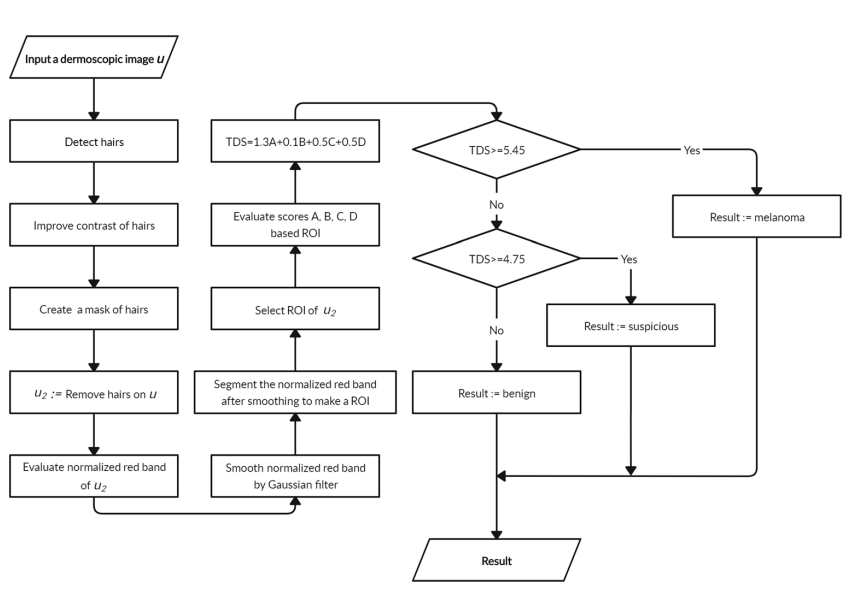
https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7256173/pdf/10278_2019_Article_316.pdf


Function = ( )
- Detect hairs by the adaptive principal curvatures.
- Improve contrast of the detected hairs.
- Segment hairs to make the hairs mask in the form of a black-white image.
- Remove hairs from skin lesions image by the inpainting method with above hairs mask.
- Calculate the normalized red band of the dermoscopic skin lesions image after removing
hairs.
- Apply the Gaussian kernel to smooth the normalized red band.
- Segment the skin lesions by the thresholding method with the global threshold calculated
by the Otsu method to make an ROI (region of interest).
- From the segmented regions of the skin lesions, calculate the asymmetry score , the
border score , the colour score and the diameter score .
- Calculate score = 1.3 + 0.1 + 0.5 + 0.5 .
- Check conditions:
If ≥ 5.45: = The melanoma skin cancer is detected.
If 4.75 ≤ < 5.45: = Suspicious case.
If < 4.75: = Benign case.


### Colours
To determine the colour score, it is necessary to consider the following colours: white, red, light brown, dark
brown, blue-grey and black. The light and dark brown
reflect melanin localised mainly in the epidermis and/or
superficial dermis; the black represents melanin in the
upper granular layer, stratum corneum or all layers of
the epidermis; the blue-grey is for melanin in the papillary
dermis, and the white corresponds to areas of regression;
and the red reflects the degree of inflammation or neovascularization. If there is a presence of one from the above
colours, the colour score will be increased by 1. The maximum colour score is 6 and the minimum colour score is
1. The impact factor of the colour score in the TDS score
is c = 0.5.

Our goal for the skin lesions segmentation focuses on
the RGB-colour model. However, we need to normalise
the colour channels before calculating the image threshold to apply the thresholding segmentation. Because the
skin tone and colours of the skin lesions usually depend
on the red channel more than the green and the blue
channels, we normalised the red band of the RGBcolour model



### Border
The border score is evaluated upon whether there is a
sharp, abrupt cut-off of pigment pattern at the periphery
of the skin lesions or a gradual, indistinct cut-off. By
this way, the lesions are divided into eight parts. The
border score is the number of parts, whether there is a sharp or gradual cut-off. The minimum border score is 0
and the maximum border score is 8. The impact factor
of the border score in the TDS score is b = 0.1.


### Asymmetry
The asymmetry score of skin lesion is evaluated based
on both the contour asymmetry and the asymmetry of the
distribution of dermoscopic colours and structures. The
asymmetry needs to be evaluated on either side of each
axis for the colours and structures and the contour of the
lesions. If there is no asymmetry in any axes, the asymmetry score is 0. If there is asymmetry by one axis, the
asymmetry score is 1. In the case of asymmetry by both
axes, the asymmetry score is 2. The impact factor of the
asymmetry score in the TDS score is a = 1.3.



https://github.com/sunnyshah2894/DigitalHairRemoval

In [8]:
hair_ids = ["PAT_691", "PAT_320", "PAT_109", "PAT_356", "PAT_681", "PAT_167", "PAT_2109", "PAT_245", "PAT_633"]

In [9]:
df_hair_test = df[df["patient_id"].isin(hair_ids)]
df_hair_test

,patient_id,lesion_id,smoke,drink,background_father,background_mother,age,pesticide,gender,skin_cancer_history,...,diameter_2,diagnostic,itch,grew,hurt,changed,bleed,elevation,img_id,biopsed
170,PAT_691,1311,False,True,POMERANIA,GERMANY,56,True,MALE,False,...,15.0,BCC,False,False,False,True,False,True,PAT_691_1311_686.png,True
201,PAT_167,258,False,False,GERMANY,GERMANY,58,True,MALE,True,...,7.0,BCC,True,True,True,True,True,True,PAT_167_258_711.png,True
274,PAT_691,3994,False,True,POMERANIA,GERMANY,56,True,MALE,False,...,10.0,ACK,False,False,False,True,False,True,PAT_691_3994_671.png,False
434,PAT_109,868,True,True,ITALY,ITALY,82,True,MALE,False,...,6.0,MEL,False,True,False,True,False,False,PAT_109_868_723.png,True
447,PAT_691,1310,False,True,POMERANIA,GERMANY,56,True,MALE,False,...,15.0,BCC,True,UNK,True,UNK,True,True,PAT_691_1310_780.png,True
661,PAT_356,736,False,True,GERMANY,UNK,58,True,MALE,True,...,12.0,BCC,True,True,False,True,False,True,PAT_356_736_188.png,True
739,PAT_356,735,False,True,GERMANY,UNK,58,True,MALE,True,...,10.0,BCC,True,True,True,False,True,True,PAT_356_735_568.png,True
740,PAT_109,868,True,True,ITALY,ITALY,82,True,MALE,False,...,6.0,MEL,False,True,False,True,False,False,PAT_109_868_113.png,True
851,PAT_356,4511,False,True,GERMANY,NaN,68,True,MALE,True,...,12.0,ACK,True,False,False,False,True,False,PAT_356_4511_960.png,False
858,PAT_691,1311,False,True,POMERANIA,GERMANY,56,True,MALE,False,...,15.0,BCC,False,False,False,True,False,True,PAT_691_1311_2.png,True


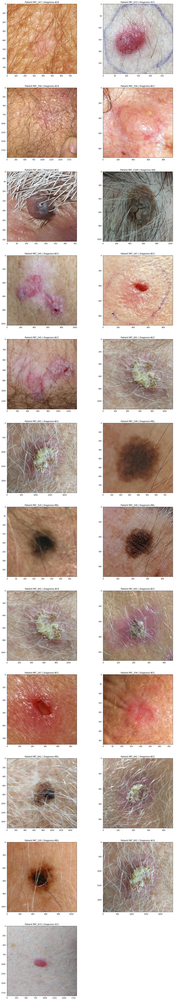

In [12]:
def show_sample_pictures(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        
        kernel = cv2.getStructuringElement(1,(17,17))
        grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
        blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
       # ret,thresh2 = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
        #dst = cv2.inpaint(img,thresh2,1,cv2.INPAINT_TELEA)
        
        axList[i].imshow(img)
        #axList[i].imshow(blackhat, cmap='gray', vmin = 0, vmax = 255)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))
    # fig.show()

diseases = df['diagnostic'].unique()

show_sample_pictures(df_hair_test, df_hair_test.shape[0])

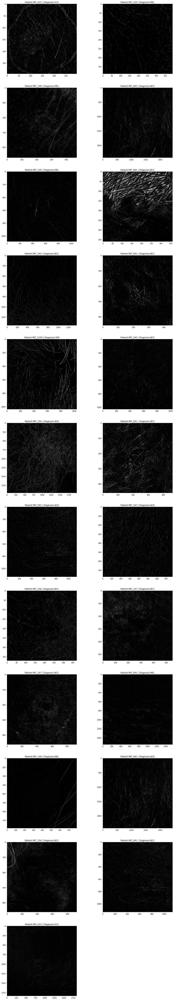

In [13]:
def show_sample_pictures(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        
        kernel = cv2.getStructuringElement(1,(17,17))
        grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
        blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
       # ret,thresh2 = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
        #dst = cv2.inpaint(img,thresh2,1,cv2.INPAINT_TELEA)
        
        #axList[i].imshow(img)
        axList[i].imshow(blackhat, cmap='gray', vmin = 0, vmax = 255)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))
    # fig.show()

diseases = df['diagnostic'].unique()

show_sample_pictures(df_hair_test, df_hair_test.shape[0])

In [14]:
df_hair_test.shape[0]

23

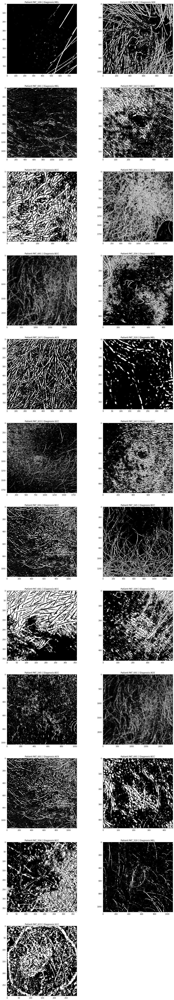

In [15]:
def show_sample_pictures(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        
        kernel = cv2.getStructuringElement(1,(17,17))
        grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
        blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
        ret,thresh2 = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
        #dst = cv2.inpaint(img,thresh2,1,cv2.INPAINT_TELEA)
        
        axList[i].imshow(thresh2, cmap='gray', vmin = 0, vmax = 255)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))
    # fig.show()

diseases = df['diagnostic'].unique()

show_sample_pictures(df_hair_test, df_hair_test.shape[0])

data/images/PAT_691_3994_791.png
data/images/PAT_167_258_711.png
data/images/PAT_167_684_365.png
data/images/PAT_245_376_24.png
data/images/PAT_320_681_410.png
data/images/PAT_691_1311_890.png
data/images/PAT_633_1199_218.png
data/images/PAT_109_868_723.png
data/images/PAT_2109_4598_112.png
data/images/PAT_356_735_568.png
data/images/PAT_356_736_188.png
data/images/PAT_691_1312_389.png
data/images/PAT_691_1311_2.png
data/images/PAT_633_1199_745.png
data/images/PAT_691_1311_686.png
data/images/PAT_320_681_724.png
data/images/PAT_691_3994_671.png
data/images/PAT_167_258_479.png
data/images/PAT_691_1310_780.png
data/images/PAT_681_1299_458.png
data/images/PAT_109_868_113.png
data/images/PAT_245_376_197.png
data/images/PAT_356_4511_960.png


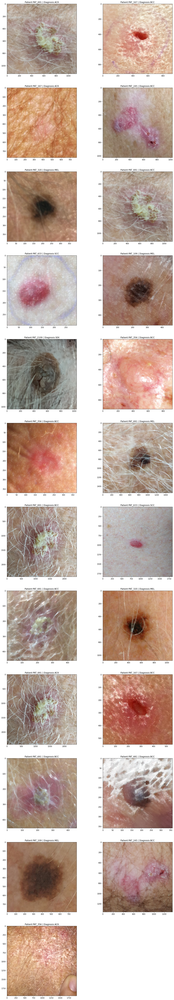

In [13]:
def show_sample_pictures(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        print(filename)
        
        kernel = cv2.getStructuringElement(1,(17,17))
        grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
        blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
        ret,thresh2 = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
        dst = cv2.inpaint(img,thresh2,5,cv2.INPAINT_NS)
        
        axList[i].imshow(dst)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))
    # fig.show()

diseases = df['diagnostic'].unique()

show_sample_pictures(df_hair_test, 23)

In [ ]:
def show_sample_pictures(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        print(filename)
        
        kernel = cv2.getStructuringElement(1,(17,17))
        grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
        blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
        ret,thresh2 = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
        dst = cv2.inpaint(img,thresh2,5,cv2.INPAINT_NS)
        
        axList[i].imshow(dst)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))
    # fig.show()

diseases = df['diagnostic'].unique()

show_sample_pictures(df_hair_test, 23)

data/images/PAT_1708_3157_518.png


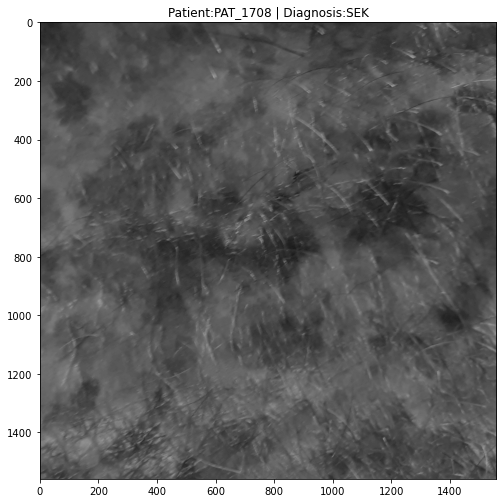

In [15]:
def test_normalize_red_band(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        print(filename)
        blank_img = img
        
        linhas,colunas,channels=img.shape
        for l in range(linhas):
              for c in range(colunas):
                    ur,ug,ub = img[l][c]
#                     print(ur,ug,ub )
                    norm = ur/math.sqrt(ur**2+ug**2+ub**2)
                    blank_img[l][c] = (norm,ug,ub)
        grayScale = cv2.cvtColor( blank_img, cv2.COLOR_RGB2GRAY )
        #axList[i].imshow(img)
        axList[i].imshow(grayScale, cmap='gray', vmin = 0, vmax = 255)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))
    # fig.show()

diseases = df['diagnostic'].unique()

test_normalize_red_band(df, 1)




data/images/PAT_1688_3066_491.png
data/images/tests/test_PAT_1688_3066_491.png
data/images/PAT_2043_4308_681.png
data/images/tests/test_PAT_2043_4308_681.png
data/images/PAT_2070_4430_290.png
data/images/tests/test_PAT_2070_4430_290.png
data/images/PAT_185_285_97.png
data/images/tests/test_PAT_185_285_97.png


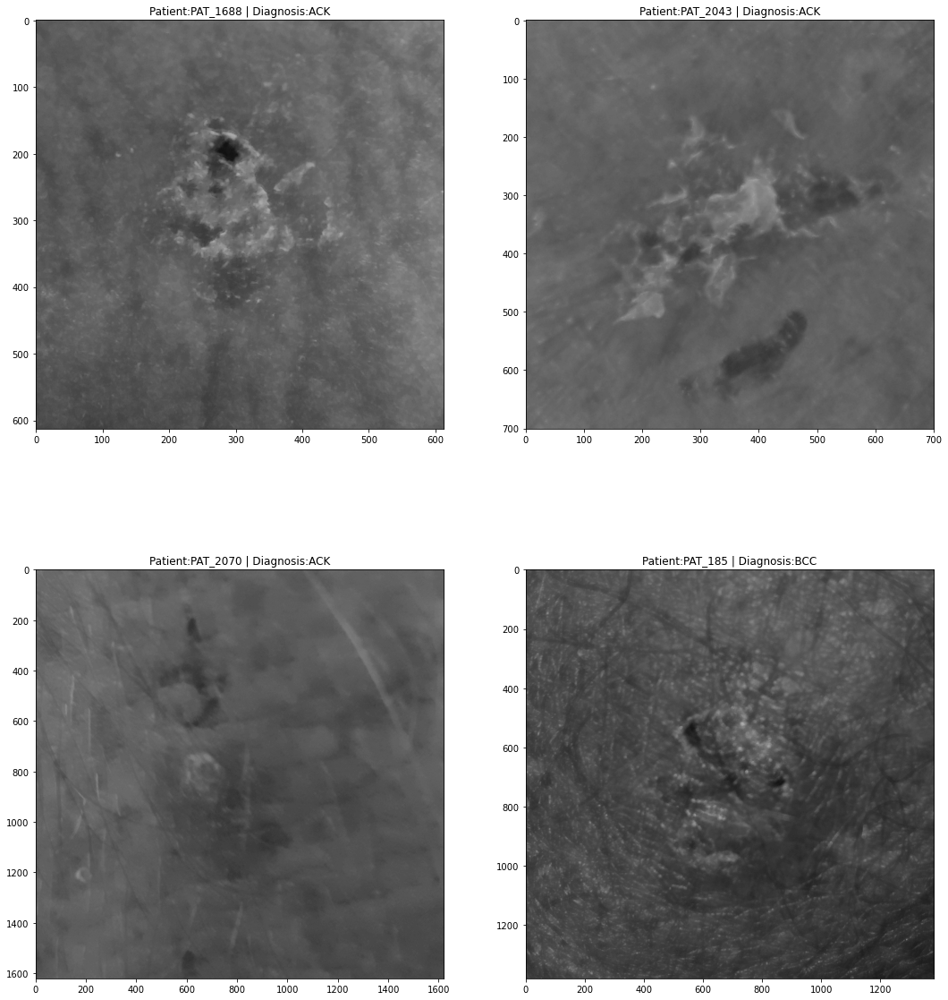

In [35]:
def test_normalize_red_band(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    processed_imgs = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        print(filename)
        blank_img = img
        
        kernel = cv2.getStructuringElement(1,(17,17))
        grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
        blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
        ret,thresh2 = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
        dst = cv2.inpaint(img,thresh2,5,cv2.INPAINT_NS)
        
        linhas,colunas,channels=img.shape
        for l in range(linhas):
              for c in range(colunas):
                    ur,ug,ub = dst[l][c]
#                     print(ur,ug,ub )
                    norm = ur/math.sqrt(ur**2+ug**2+ub**2)
                    blank_img[l][c] = (norm,ug,ub)
        grayScale = cv2.cvtColor( blank_img, cv2.COLOR_RGB2GRAY )
        #axList[i].imshow(img)
        
        
        print(f"data/images/tests/test_{imgs[i]}")
        cv2.imwrite(f"data/images/tests/test_{imgs[i]}", grayScale)

        axList[i].imshow(grayScale, cmap='gray', vmin = 0, vmax = 255)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))
        
        processed_imgs.append(f"data/images/tests/test_{imgs[i]}")
        
    return processed_imgs
        
    # fig.show()

diseases = df['diagnostic'].unique()

processed_imgs = test_normalize_red_band(df, 4)




data/images/PAT_385_783_574.png
data/images/tests/test_PAT_385_783_574.png


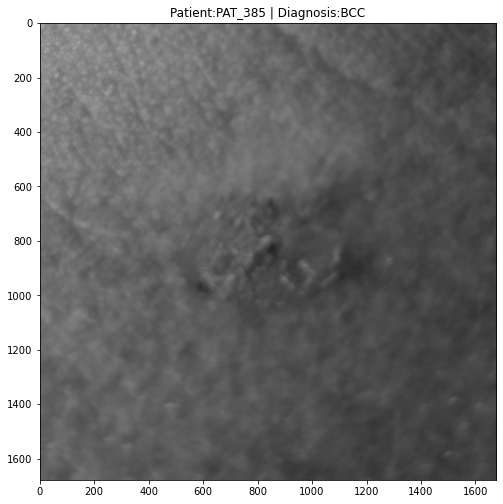

In [8]:
def test_normalize_red_band(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    processed_imgs = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        print(filename)
        blank_img = img
        
        kernel = cv2.getStructuringElement(1,(17,17))
        grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
        blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
        ret,thresh2 = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
        dst = cv2.inpaint(img,thresh2,5,cv2.INPAINT_TELEA)
        
        linhas,colunas,channels=img.shape
        for l in range(linhas):
              for c in range(colunas):
                    ur,ug,ub = dst[l][c]
#                     print(ur,ug,ub )
                    norm = ur/math.sqrt(ur**2+ug**2+ub**2)
                    blank_img[l][c] = (norm,ug,ub)
        grayScale = cv2.cvtColor( blank_img, cv2.COLOR_RGB2GRAY )
        #axList[i].imshow(img)
        
        
        print(f"data/images/tests/test_{imgs[i]}")
        cv2.imwrite(f"data/images/tests/test_{imgs[i]}", grayScale)

        axList[i].imshow(grayScale, cmap='gray', vmin = 0, vmax = 255)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))
        
        processed_imgs.append(f"data/images/tests/test_{imgs[i]}")
        
    return processed_imgs
        
    # fig.show()

diseases = df['diagnostic'].unique()

processed_imgs = test_normalize_red_band(df, 1)




In [39]:
test_imgs = ["PAT_1577_3527_831.png"]

In [40]:
def hsv_histeq(img_gray):
    value=90
    bgr = cv2.cvtColor(img_gray, cv2.COLOR_GRAY2BGR)
    hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)
    imgeq=cv2.equalizeHist(v)

    final_hsv = cv2.merge((h, s, imgeq))
    img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return img_gray

data/images/PAT_1577_3527_831.png
data/images/tests/test_PAT_1577_3527_831.png


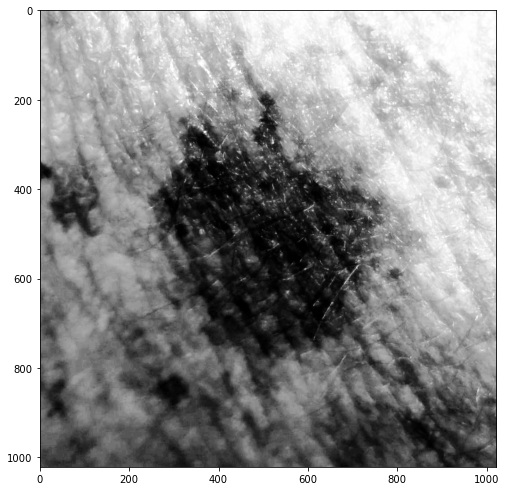

In [52]:
def test_img(test_imgs, n_samples=9):
    imgs = test_imgs
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    processed_imgs = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        print(filename)
        blank_img = img
        
## Tirar pelos da pele
        kernel = cv2.getStructuringElement(1,(17,17))
        grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
        blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
        ret,thresh2 = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
        dst = cv2.inpaint(img,thresh2,5,cv2.INPAINT_TELEA)
        
        
        linhas,colunas,channels=img.shape
        for l in range(linhas):
              for c in range(colunas):
                    ur,ug,ub = dst[l][c]
#                     print(ur,ug,ub )
                    norm = ur/math.sqrt(ur**2+ug**2+ub**2)
                    blank_img[l][c] = (norm,ug,ub)
        grayScale = cv2.cvtColor( blank_img, cv2.COLOR_RGB2GRAY )
 
### Equalizacao do histograma
       # dst_gray = cv2.cvtColor( grayScale, cv2.COLOR_RGB2GRAY )
        imgeq = hsv_histeq(grayScale)
        
          
        #axList[i].imshow(img)
        
        
        print(f"data/images/tests/test_{imgs[i]}")
        cv2.imwrite(f"data/images/tests/test_{imgs[i]}", imgeq)

        axList[i].imshow(imgeq, cmap='gray', vmin = 0, vmax = 255)
        
        processed_imgs.append(f"data/images/tests/test_{imgs[i]}")
        
    return processed_imgs
        
    # fig.show()

diseases = df['diagnostic'].unique()

processed_imgs = test_img(test_imgs, 1)




data/images/tests/test_PAT_1577_3527_831.png
found


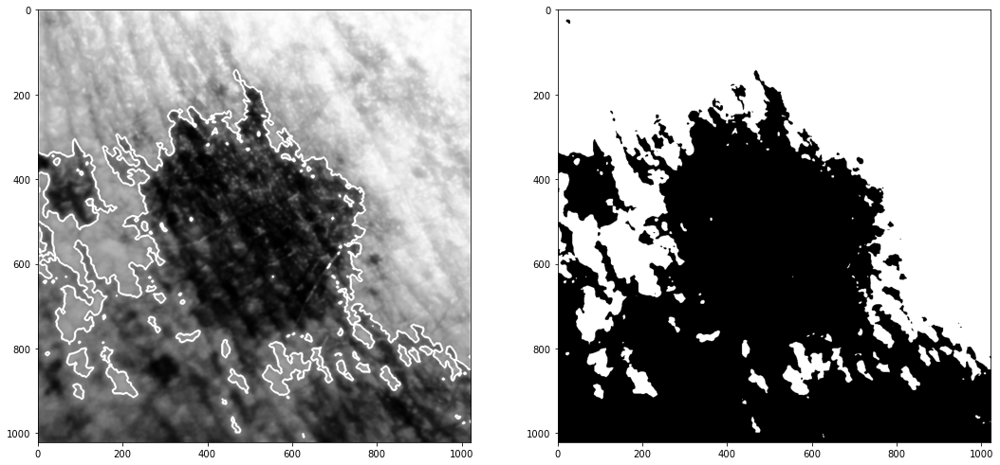

In [63]:
fig = plt.figure(figsize=(18,8*((len(processed_imgs)+4)//2)))
axList = []
for i in range(len(processed_imgs)):
    axList.append(fig.add_subplot((2+len(processed_imgs))//2,2,i+1))
    axList.append(fig.add_subplot((2+len(processed_imgs))//2,2,i+2))
    print (processed_imgs[i])
    img = cv2.imread(processed_imgs[i])[:,:,::-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    #edges = cv2.Canny(img,100,200)
    
    blur = cv2.GaussianBlur(img,(11,11),0)
    
    T,imgt = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

    T,imgt3 = cv2.threshold(blur,np.median(blur),255,cv2.THRESH_BINARY)
    
    
    contours, hierarchy = cv2.findContours(imgt.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

    if len(contours) != 0:
            print("found")
            # draw in blue the contours that were founded
            cv2.drawContours(blur, contours, -1, 255, 3)
            c = max(contours, key = cv2.contourArea)
            x,y,w,h = cv2.boundingRect(c)
            
        

    axList[i].imshow(blur, cmap='gray', vmin = 0, vmax = 255)
    axList[i+1].imshow(imgt, cmap='gray', vmin = 0, vmax = 255)
    

In [ ]:
fig = plt.figure(figsize=(18,8*((len(processed_imgs)+4)//2)))
axList = []
processed_imgs = []
for i in range(len(processed_imgs)):
    axList.append(fig.add_subplot((2+len(processed_imgs))//2,2,i+1))
    print (processed_imgs[i])
    img = cv2.imread(processed_imgs[i])[:,:,::-1]
     _, contours,hierarchy = cv2.findContours(thresh,2,1)
    cnt = contours
 for i in range (len(cnt)):
     (x,y),radius = cv2.minEnclosingCircle(cnt[i])
     center = (int(x),int(y))
     radius = int(radius)
     cv2.circle(thresh,center,radius,(0,255,0),2)
     print ('Circle: ' + str(i) + ' - Center: ' + str(center) + ' - Radius: ' + str(radius))
        
    axList[i].imshow(edges, cmap='gray', vmin = 0, vmax = 255)

In [ ]:
# Segunda iteração

back_gray = cv.cvtColor(back, cv.COLOR_BGR2GRAY)
frame_gray = cv.cvtColor(frame, cv.COLOR_BGR2GRAY)

blurback=cv.blur(back_gray,(5,5))
blurframe=cv.blur(frame_gray,(11,11))  # imagem borrada para diminuir detalhes

obj_gray = blurframe - back_gray

T,imgt = cv.threshold(obj_gray,240,255,cv.THRESH_BINARY) #threshold aumentado

cv2_imshow(imgt)



In [67]:
microdf = df.sample(5).reset_index()
test_imgs = microdf['img_id'].to_list()
test_imgs

['PAT_917_1735_936.png',
 'PAT_1329_1168_620.png',
 'PAT_1460_1598_746.png',
 'PAT_609_1159_932.png',
 'PAT_96_150_743.png']

data/images/PAT_917_1735_936.png
data/images/tests/test_PAT_917_1735_936.png
data/images/PAT_1329_1168_620.png
data/images/tests/test_PAT_1329_1168_620.png
data/images/PAT_1460_1598_746.png
data/images/tests/test_PAT_1460_1598_746.png
data/images/PAT_609_1159_932.png
data/images/tests/test_PAT_609_1159_932.png
data/images/PAT_96_150_743.png
data/images/tests/test_PAT_96_150_743.png


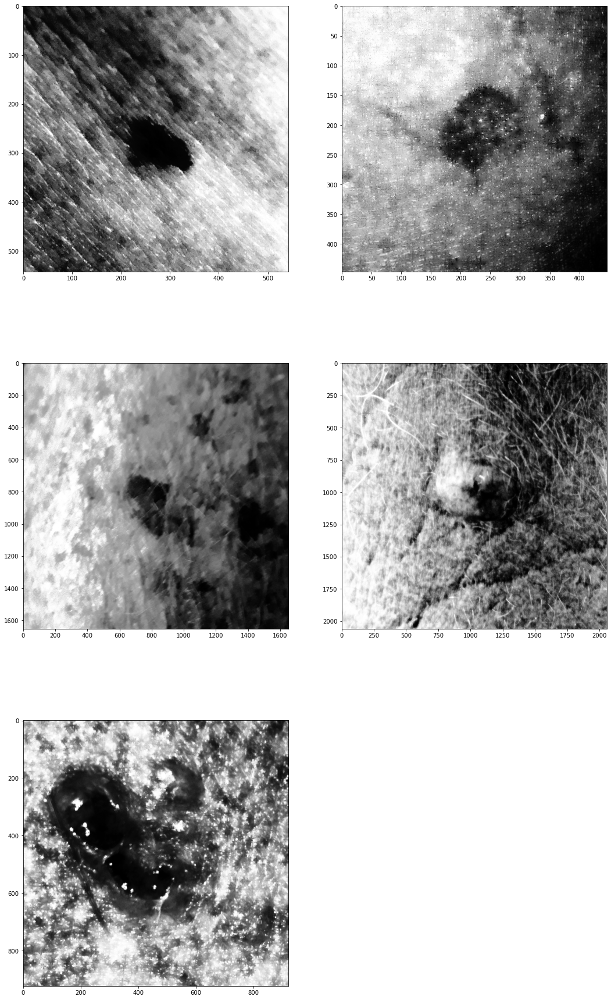

In [68]:
def test_img(test_imgs, n_samples=9):
    imgs = test_imgs
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    processed_imgs = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = 'data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        print(filename)
        blank_img = img
        
## Tirar pelos da pele
        kernel = cv2.getStructuringElement(1,(17,17))
        grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
        blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
        ret,thresh2 = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
        dst = cv2.inpaint(img,thresh2,5,cv2.INPAINT_TELEA)
        
        
        linhas,colunas,channels=img.shape
        for l in range(linhas):
              for c in range(colunas):
                    ur,ug,ub = dst[l][c]
#                     print(ur,ug,ub )
                    norm = ur/math.sqrt(ur**2+ug**2+ub**2)
                    blank_img[l][c] = (norm,ug,ub)
        grayScale = cv2.cvtColor( blank_img, cv2.COLOR_RGB2GRAY )
 
### Equalizacao do histograma
       # dst_gray = cv2.cvtColor( grayScale, cv2.COLOR_RGB2GRAY )
        imgeq = hsv_histeq(grayScale)
        
          
        #axList[i].imshow(img)
        
        
        print(f"data/images/tests/test_{imgs[i]}")
        cv2.imwrite(f"data/images/tests/test_{imgs[i]}", imgeq)

        axList[i].imshow(imgeq, cmap='gray', vmin = 0, vmax = 255)
        
        processed_imgs.append(f"data/images/tests/test_{imgs[i]}")
        
    return processed_imgs
        
    # fig.show()

diseases = df['diagnostic'].unique()

processed_imgs = test_img(test_imgs, len(test_imgs))




In [78]:
processed_imgs = ["data/images/tests/test_PAT_917_1735_936.png",
"data/images/tests/test_PAT_1329_1168_620.png",
"data/images/tests/test_PAT_1460_1598_746.png",
"data/images/tests/test_PAT_609_1159_932.png",
"data/images/tests/test_PAT_96_150_743.png"]

data/images/tests/test_PAT_917_1735_936.png
found
data/images/tests/test_PAT_1329_1168_620.png
found
data/images/tests/test_PAT_1460_1598_746.png
found
data/images/tests/test_PAT_609_1159_932.png
found
data/images/tests/test_PAT_96_150_743.png
found


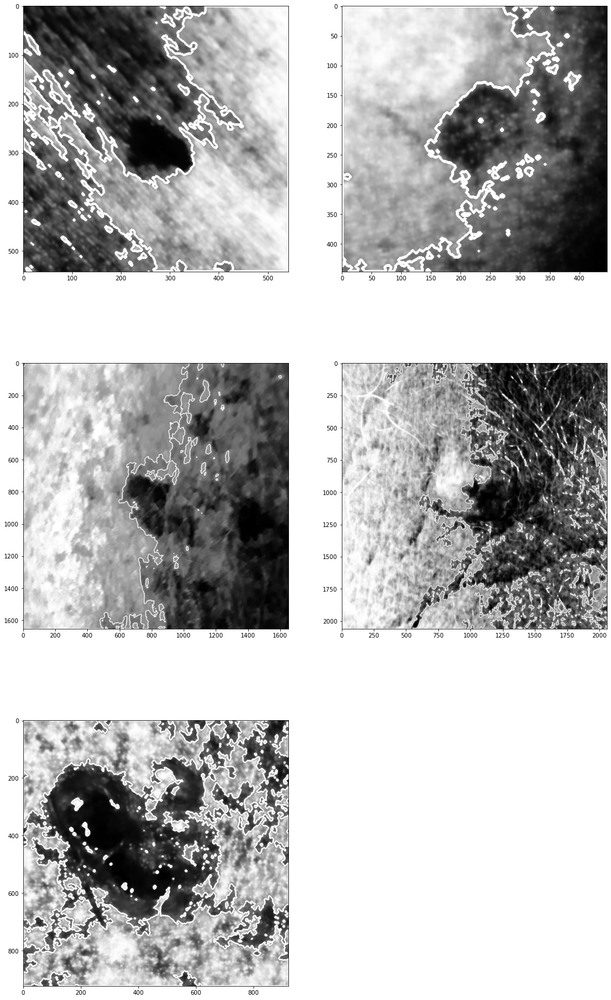

In [93]:
fig = plt.figure(figsize=(18,8*((len(processed_imgs)+4)//2)))
axList = []
for i in range(len(processed_imgs)):
    axList.append(fig.add_subplot((2+len(processed_imgs))//2,2,i+1))
#     axList.append(fig.add_subplot((2+len(processed_imgs))//2,2,i+2))
    print (processed_imgs[i])
    img = cv2.imread(processed_imgs[i])[:,:,::-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    #edges = cv2.Canny(img,100,200)
    
    blur = cv2.GaussianBlur(img,(11,11),0)
    
    T,imgt = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

    T,imgt3 = cv2.threshold(blur,np.median(blur),255,cv2.THRESH_BINARY)
    
    
    contours, hierarchy = cv2.findContours(imgt.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

    if len(contours) != 0:
            print("found")
            # draw in blue the contours that were founded
            cv2.drawContours(blur, contours, -1, 255, 3)
            c = max(contours, key = cv2.contourArea)
            x,y,w,h = cv2.boundingRect(c)
            
        

    axList[i].imshow(blur, cmap='gray', vmin = 0, vmax = 255)
#     axList[i+1].imshow(imgt, cmap='gray', vmin = 0, vmax = 255)
    

https://www.faqcode4u.com/faq/416636/how-to-identify-if-the-shapes-of-an-image-are-symmetric-or-asymmetric-using-open